In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import os
import pandas as pd

import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

train = pd.read_csv('/kaggle/input/planttraits2024/train.csv')
image_directory = "/kaggle/input/planttraits2024/train_images"
meta = pd.read_csv('/kaggle/input/planttraits2024/target_name_meta.tsv', sep='\t')

# Plant Traits / Descriptions

In [2]:
#all columns must be identical to be consider the same species
trait_columns = ['X4_mean', 'X11_mean', 'X18_mean', 'X50_mean', 'X26_mean', 'X3112_mean']

for column in trait_columns:
    trait_desc = meta.loc[meta['trait_ID'] == column.replace("_mean", "")].values[0][1]
    print(column, "\t", trait_desc)

X4_mean 	 Stem specific density (SSD) or wood density (stem dry mass per stem fresh volume) 
X11_mean 	 Leaf area per leaf dry mass (specific leaf area, SLA or 1/LMA) 
X18_mean 	 Plant height 
X50_mean 	 Leaf nitrogen (N) content per leaf area 
X26_mean 	 Seed dry mass 
X3112_mean 	 Leaf area (in case of compound leaves: leaf, undefined if petiole in- or excluded) 


# Generate "species" identifier
### Assigns the same value for plants that match all X_mean values

#### Note: This approach causes species IDs to be assigned in order of X4 values

In [3]:
train['species'] = train.groupby(trait_columns).ngroup()
species_counts = train['species'].nunique()

print (f"{species_counts} unique species found in {len(train)} records")

19799 unique species found in 55489 records


# Most species have only a couple images

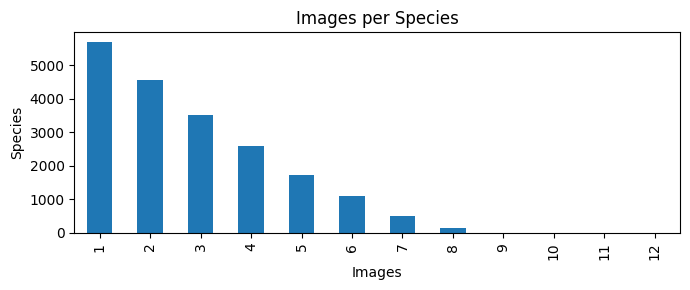

In [4]:
species_counts = train['species'].value_counts()
count_summary = species_counts.value_counts().sort_index()
count_summary.plot(kind='bar', figsize=(7, 3))

plt.title('Images per Species')
plt.xlabel('Images')
plt.ylabel('Species')

# Show the plot
plt.tight_layout() 
plt.show()

# Function to display most common species
### Displays up to max_images per max_species for dataset
### (sorted descending by # of images)

In [5]:
def display_plants(plant_df, max_species = 10, max_images=10):
    
    # Most populace species are displayed first    
    df_species_counts = plant_df['species'].value_counts()
    
    for species in df_species_counts.head(max_species).index:
        display_data = plant_df[plant_df.species == species]

        display_data = display_data.head(max_images)
        print(f"Species ID: {int(display_data.iloc[0].species)}")
        
        for trait in trait_columns:
            print(f"{trait}: {round(display_data.iloc[0][trait], 4)}  ", end="")

        ncols = 5
        nrows = int(np.ceil(len(display_data) / ncols))

        fig, axs = plt.subplots(nrows, ncols, figsize=(15, 3 * nrows))
        axs = axs.flatten()

        for idx, (i, row) in enumerate(display_data.iterrows()):
            if idx >= len(axs):  # Check to avoid IndexError
                break
            image_id = int(row['id'])
            image_path = os.path.join(image_directory, f"{image_id}.jpeg")
            img = mpimg.imread(image_path)
            axs[idx].imshow(img)
            axs[idx].axis('off')  # Hide axes

        # Hide unused subplots
        for ax in axs[len(display_data):]:
            ax.axis('off')

        warnings.filterwarnings('ignore', category=UserWarning)
        plt.tight_layout()
        plt.show()
        
        print(display_data['id'].values)
        
        print ("\n")

# A few of the most common species

Species ID: 8840
X4_mean: 0.4881  X11_mean: 14.5724  X18_mean: 13.2506  X50_mean: 0.9374  X26_mean: 834.9381  X3112_mean: 5894.561  

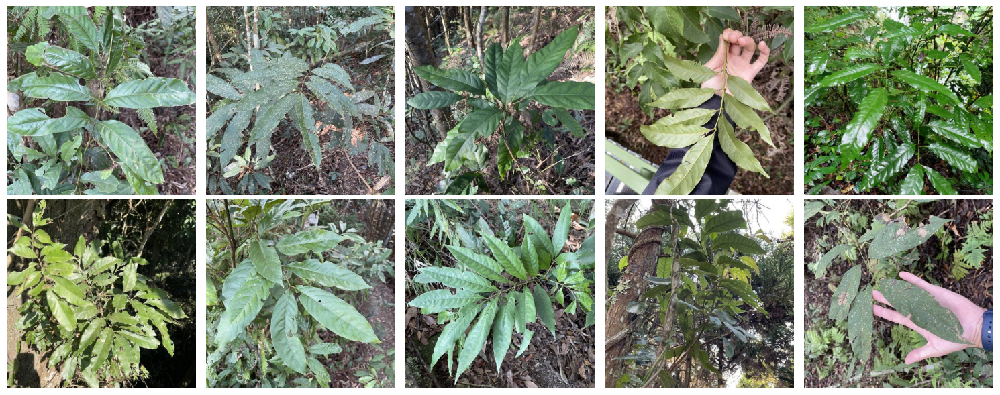

[196269149 196267974 196269153 196342114 195147502 194734309 196269152
 196267969 196269146 194470384]


Species ID: 16021
X4_mean: 0.6546  X11_mean: 21.4955  X18_mean: 0.3374  X50_mean: 1.4682  X26_mean: 4.2152  X3112_mean: 630.8832  

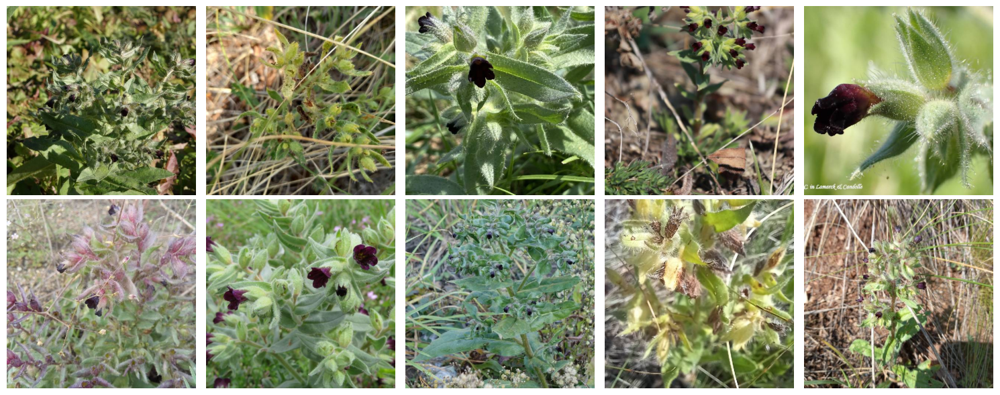

[196635553 194497237 194809022 196457206 196509754 196540545 195016756
 196629628 194499999 194501047]


Species ID: 778
X4_mean: 0.2967  X11_mean: 35.4191  X18_mean: 0.1338  X50_mean: 1.018  X26_mean: 2.1643  X3112_mean: 979.1491  

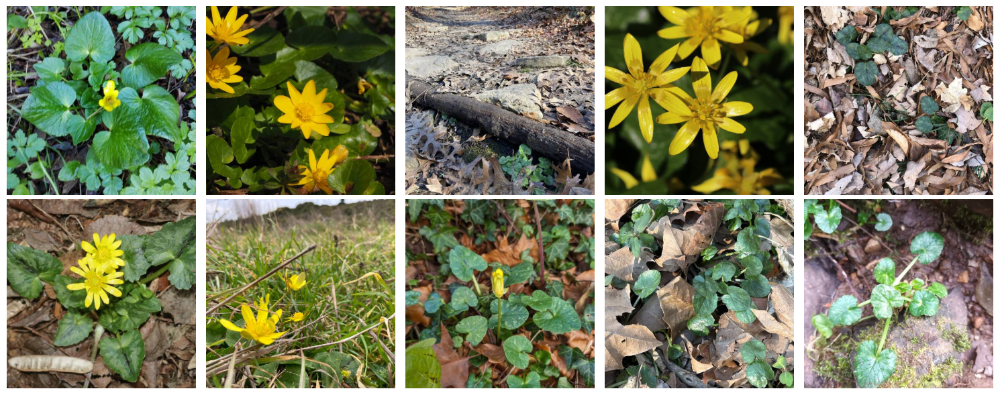

[195678028 195674815 195680425 196691650 196699712 196673904 195682370
 196674459 195681088 196677215]


Species ID: 10646
X4_mean: 0.5301  X11_mean: 43.4148  X18_mean: 0.2073  X50_mean: 1.021  X26_mean: 14.5283  X3112_mean: 2397.3261  

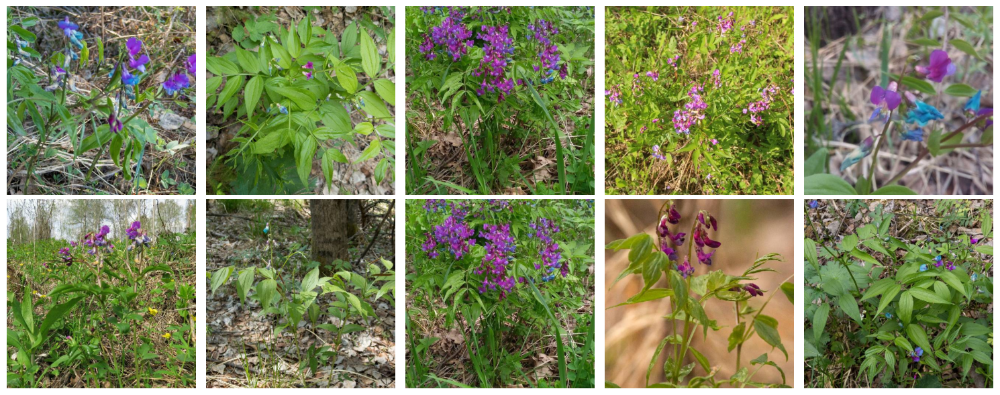

[196112268 195677178 196487858 196304526 195919485 196416666 195572702
 196203210 195357987 195562925]


Species ID: 5284
X4_mean: 0.4215  X11_mean: 18.7844  X18_mean: 0.0911  X50_mean: 1.0945  X26_mean: 2.6181  X3112_mean: 1869.9542  

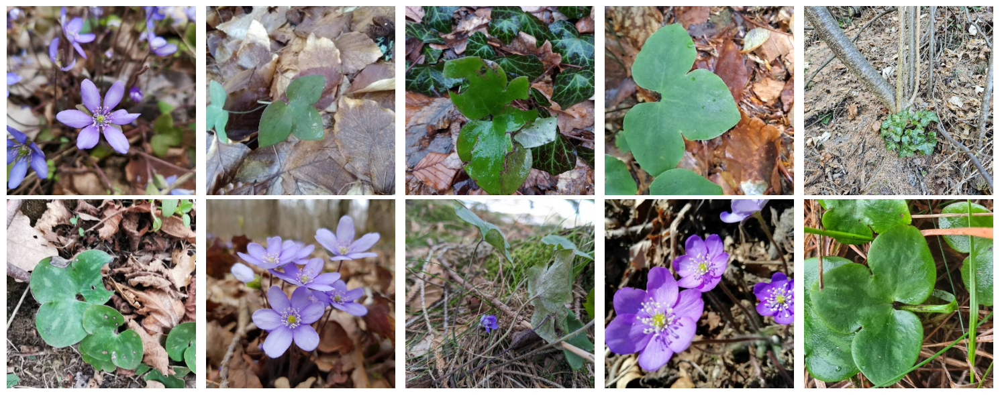

[195929317 195774618 195650677 195880009 195773657 195567265 195844898
 195848484 195611107 195935028]


Species ID: 205
X4_mean: 0.2296  X11_mean: 14.1143  X18_mean: 0.1137  X50_mean: 1.1155  X26_mean: 0.0002  X3112_mean: 2.0128  

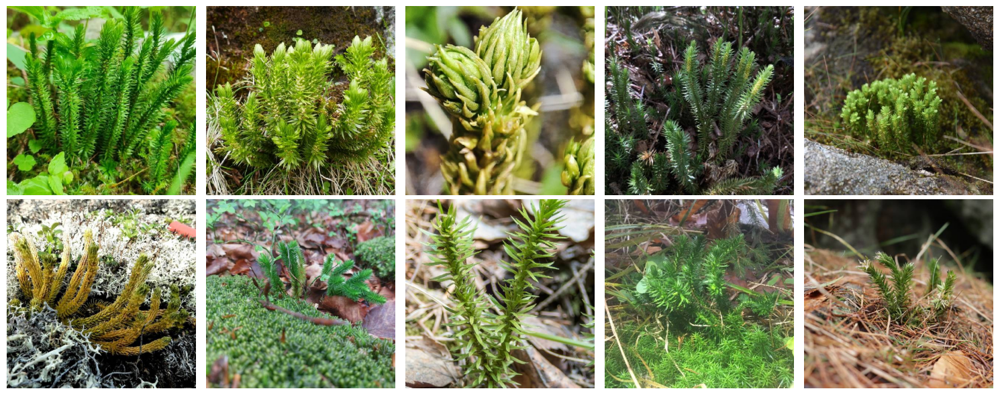

[195262662 195830093 195267889 195066122 195511896 196225599 196358346
 195591175 195368117 195314820]


Species ID: 14463
X4_mean: 0.6158  X11_mean: 10.3661  X18_mean: 0.4926  X50_mean: 1.3938  X26_mean: 0.2264  X3112_mean: 11.2909  

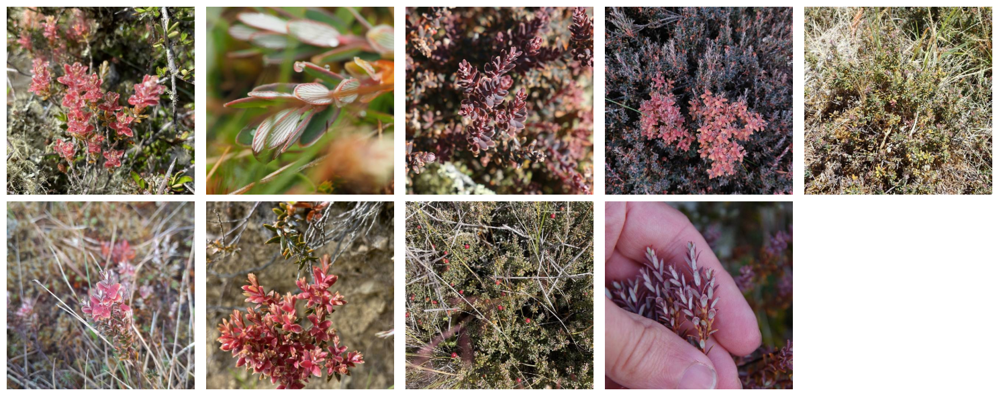

[195037127 196487406 195975329 196387738 195647417 195322730 195037835
 196710993 195339012]


Species ID: 6807
X4_mean: 0.4518  X11_mean: 19.2362  X18_mean: 2.412  X50_mean: 1.4252  X26_mean: 8.5315  X3112_mean: 1347.5936  

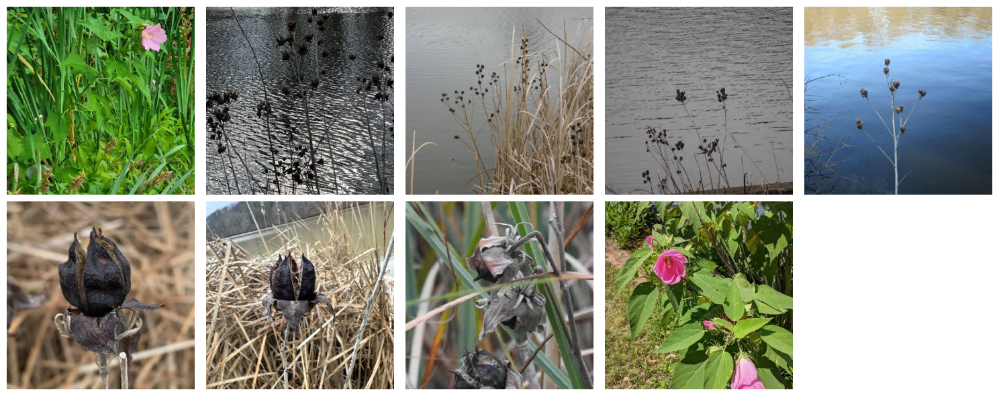

[196541503 196632029 195775830 195838481 196588209 196454688 196459611
 195687344 195809316]




In [6]:
display_plants(train, max_species = 8, max_images = 10)

# X4 < -1.0 species
#### Species ID 7: https://en.wikipedia.org/wiki/Welwitschia
#### (low species numbers here are due to how IDs are generated - not a data anomoly)

Species ID: 7
X4_mean: -1.467  X11_mean: 0.0037  X18_mean: 0.0031  X50_mean: 1229.6081  X26_mean: 155130.6813  X3112_mean: 1.1329  

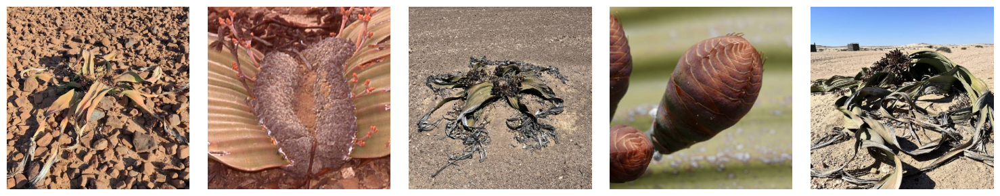

[195309016 194810962 195921261 194798684 195353035]


Species ID: 8
X4_mean: -1.1631  X11_mean: 2532.0915  X18_mean: 0.0  X50_mean: 0.0182  X26_mean: 1011.2393  X3112_mean: 4.3669  

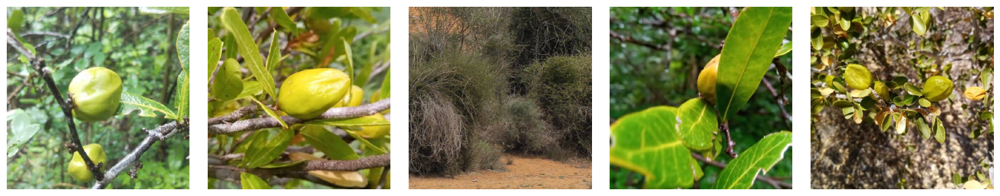

[110550944 147745894  70566365 110377138 163276206]


Species ID: 5
X4_mean: -1.6221  X11_mean: 90.8412  X18_mean: 17.5767  X50_mean: 0.2062  X26_mean: 7231.2849  X3112_mean: 9873086.104  

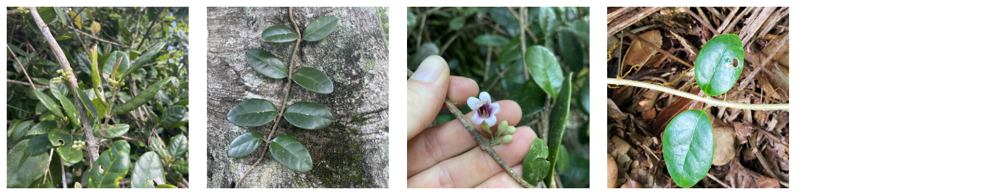

[187955133 187965901 195016760 186688852]


Species ID: 0
X4_mean: -2.4312  X11_mean: 56912.6784  X18_mean: 0.0  X50_mean: 0.0078  X26_mean: 3.6545  X3112_mean: 29.891  

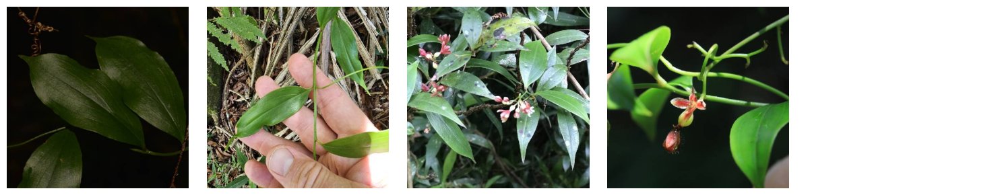

[192913235 194959341 195189801 192673953]


Species ID: 6
X4_mean: -1.5333  X11_mean: 0.0014  X18_mean: 157.6849  X50_mean: 1263.5936  X26_mean: 0.0788  X3112_mean: 2.2906  

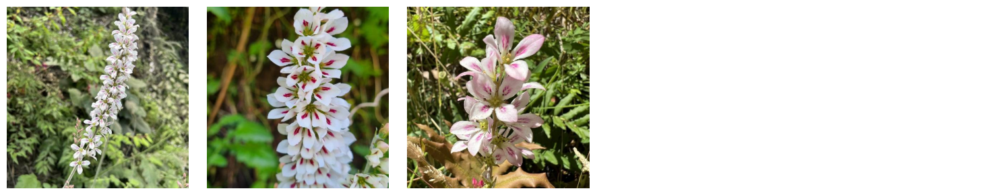

[196130655 196144622 196167196]




In [7]:
display_plants(train[train["X4_mean"] < -1.0], max_species = 5, max_images = 5)

# Mislabeled -not- tall species (X18 > 500)

Species ID: 47
X4_mean: -0.0336  X11_mean: 78.2614  X18_mean: 75967.5858  X50_mean: 0.06  X26_mean: 11.3031  X3112_mean: 17314.9618  

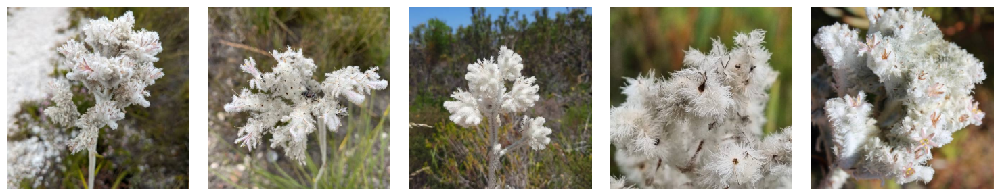

[195680574 195160453 195271204 195662179 195551861]


Species ID: 17639
X4_mean: 0.7181  X11_mean: 95.3219  X18_mean: 134997.0568  X50_mean: 0.0475  X26_mean: 0.0044  X3112_mean: 3812.7028  

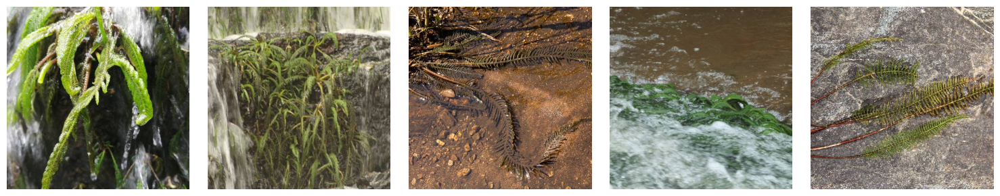

[102240983 117145923 134720679 192547275 177330086]


Species ID: 19793
X4_mean: 2.3982  X11_mean: 9.9404  X18_mean: 705177.7006  X50_mean: 0.0541  X26_mean: 8920578.698  X3112_mean: 3683.3689  

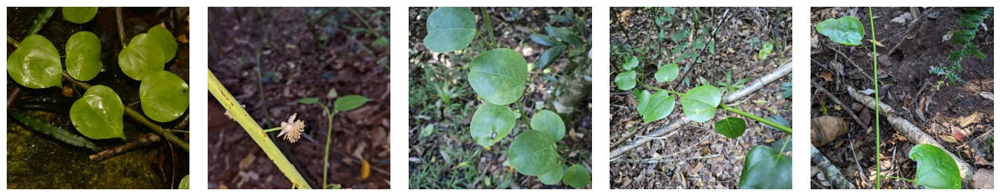

[192899733 191222733 192803371 191162615 191222760]


Species ID: 19791
X4_mean: 2.0126  X11_mean: 253.5396  X18_mean: 272049414.7  X50_mean: 0.1158  X26_mean: 4.2551  X3112_mean: 2770957.527  

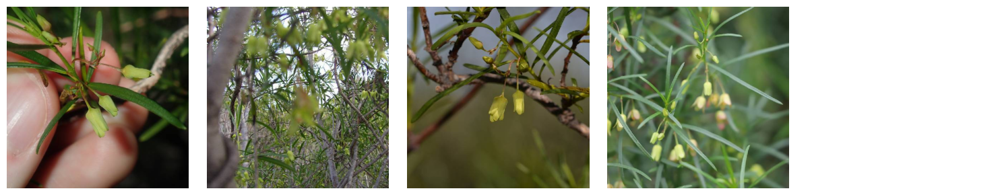

[128260887  18699941 128786099 101425452]


Species ID: 13129
X4_mean: 0.5856  X11_mean: 7.365  X18_mean: 3081.0727  X50_mean: 1.2829  X26_mean: 34.1336  X3112_mean: 684776.7667  

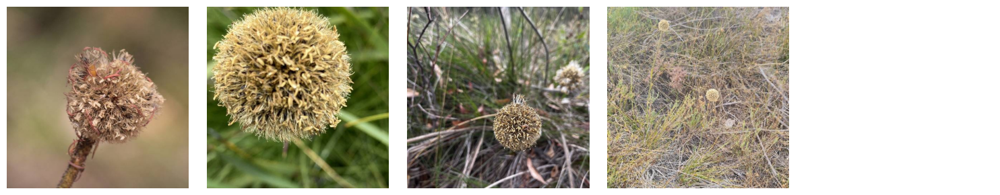

[194951954 193947065 195245185 194091952]


Species ID: 63
X4_mean: 0.1225  X11_mean: 0.7641  X18_mean: 1814.0156  X50_mean: 5.3437  X26_mean: 2.3145  X3112_mean: 25.3888  

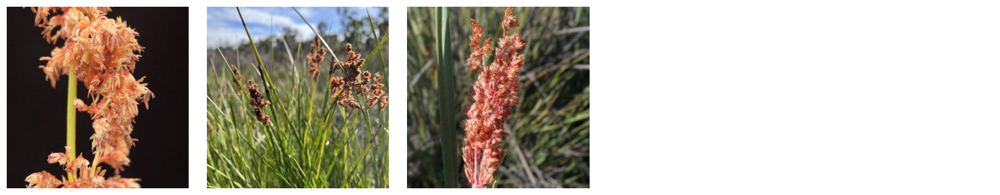

[133306565 127780894 130477530]


Species ID: 19796
X4_mean: 2.4858  X11_mean: 0.3548  X18_mean: 5199.8257  X50_mean: 1.8547  X26_mean: 2.4631  X3112_mean: 10560.79  

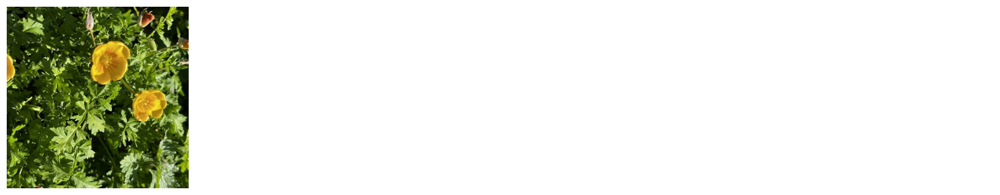

[106443036]




In [8]:
display_plants(train[train["X18_mean"] > 500], max_species = 10, max_images = 5)

# Actual tall species (40 < X18 < 60)
#### Although 18364 appears to be a plum tree - not nearly as tall as the various fir trees

Species ID: 6485
X4_mean: 0.4456  X11_mean: 4.9964  X18_mean: 44.2592  X50_mean: 2.4626  X26_mean: 6.5874  X3112_mean: 95.1019  

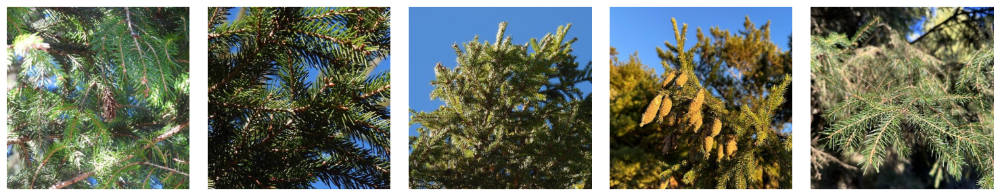

[193015471 193015469 193015463 194318805 192453836]


Species ID: 1110
X4_mean: 0.3125  X11_mean: 66.7359  X18_mean: 47.7381  X50_mean: 0.7154  X26_mean: 0.3232  X3112_mean: 16642.1659  

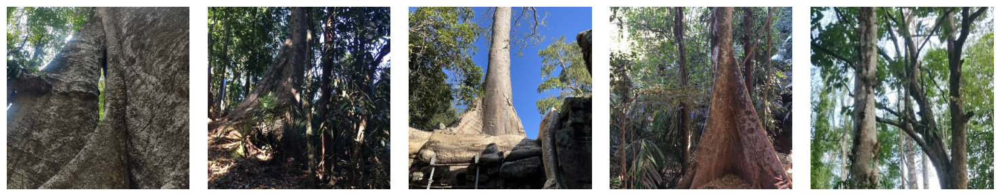

[195556559 194983129 195653317 194983132 195558440]


Species ID: 2792
X4_mean: 0.3676  X11_mean: 7.4218  X18_mean: 41.9189  X50_mean: 1.9222  X26_mean: 16.1578  X3112_mean: 236.35  

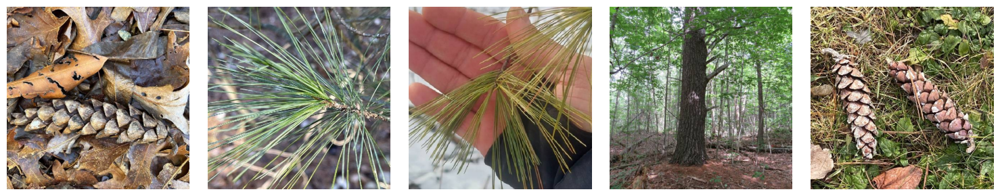

[196623284 196634653 196593367 196625458 196621610]


Species ID: 5820
X4_mean: 0.432  X11_mean: 4.4788  X18_mean: 49.5173  X50_mean: 2.8423  X26_mean: 12.368  X3112_mean: 145.6018  

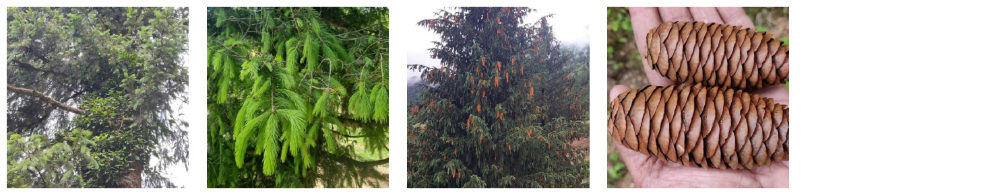

[168686966 172804380 174647311 168687558]


Species ID: 3536
X4_mean: 0.3864  X11_mean: 7.2971  X18_mean: 52.7256  X50_mean: 1.8531  X26_mean: 22.4863  X3112_mean: 104.421  

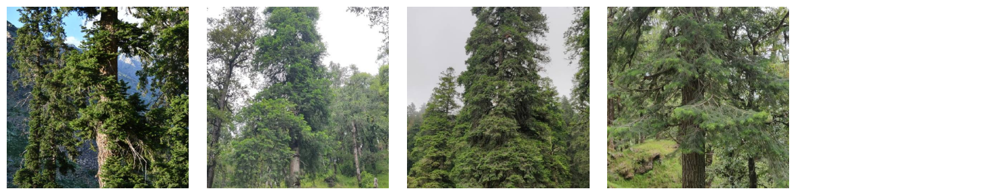

[138407640 168686898 168688375 168686633]


Species ID: 19566
X4_mean: 0.9026  X11_mean: 13.7999  X18_mean: 40.8749  X50_mean: 1.9673  X26_mean: 58.4845  X3112_mean: 3255.8561  

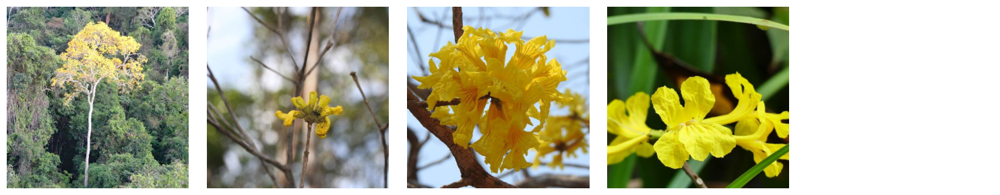

[134303018  99890784  93290802  92060225]


Species ID: 3902
X4_mean: 0.3933  X11_mean: 3.3016  X18_mean: 47.5002  X50_mean: 3.3061  X26_mean: 111.1138  X3112_mean: 189.9888  

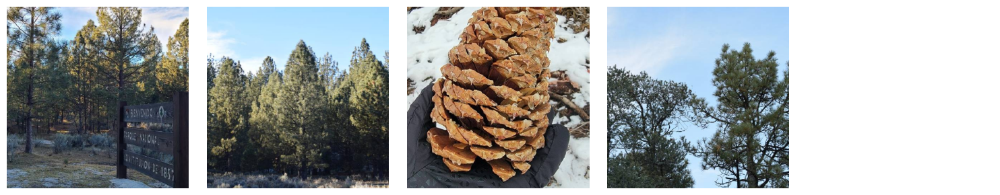

[195698223 195698206 195764418 195705883]


Species ID: 18364
X4_mean: 0.7669  X11_mean: 11.3386  X18_mean: 57.5857  X50_mean: 1.1562  X26_mean: 309.4899  X3112_mean: 3702.3528  

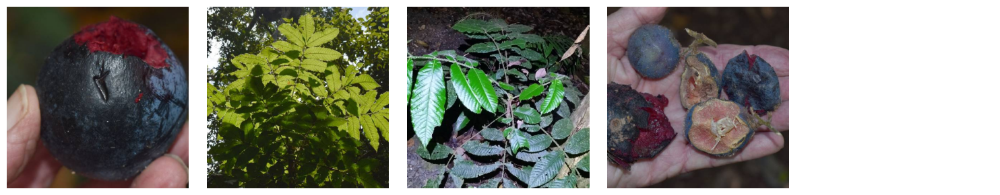

[195876411 194100797 191751027 188305538]


Species ID: 18311
X4_mean: 0.7618  X11_mean: 9.969  X18_mean: 41.851  X50_mean: 1.6535  X26_mean: 311.8998  X3112_mean: 9988.384  

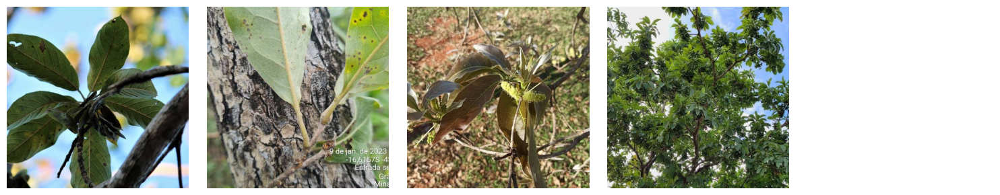

[176266192 146518952 182743622 147452613]


Species ID: 10752
X4_mean: 0.533  X11_mean: 8.6606  X18_mean: 47.5296  X50_mean: 1.6641  X26_mean: 4315.8655  X3112_mean: 7221.6539  

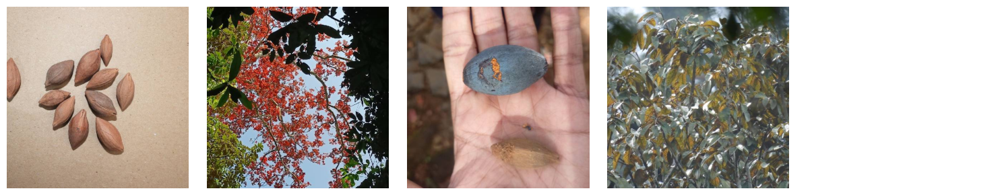

[190047120 191164057 194744221 193711284]




In [9]:
display_plants(train[(train["X18_mean"] < 60) & (train["X18_mean"] > 40)], max_species = 10, max_images = 5)